In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [ ]:
# This code performs a specific task
from sklearn.datasets import fetch_lfw_people
import matplotlib.pyplot as plt
import numpy as np
import cv2
import warnings
warnings.filterwarnings("ignore")
from collections import Counter

In [ ]:
# This code performs a specific task
from torch.utils.data import Dataset, DataLoader
import cv2
import torch
import torch.nn as nn
import torch.optim as optim

import torchvision.transforms as transforms
from sklearn.cluster import KMeans
import torch.nn.functional as F

In [ ]:
# import seaborn as sns
from sklearn.manifold import TSNE

In [ ]:
# This code performs a specific task
lfw_people=fetch_lfw_people(min_faces_per_person = 60, color = True)

In [ ]:
# This code performs a specific task
images=lfw_people.images
images.shape

(1348, 62, 47, 3)

In [ ]:
# This code performs a specific task
target_name=lfw_people.target_names
# target_namedddd

array(['Ariel Sharon', 'Colin Powell', 'Donald Rumsfeld', 'George W Bush',
       'Gerhard Schroeder', 'Hugo Chavez', 'Junichiro Koizumi',
       'Tony Blair'], dtype='<U17')

In [ ]:
# This code performs a specific task
cluster_dataset = {}
total = 0
all_images = []
labels = []

for i in list(set(lfw_people.target)):
    cluster1 = images[lfw_people.target == i][:60]
    total += len(cluster1)
    cluster_dataset[i] = cluster1
    all_images.append(cluster1)
    labels.append([i for _ in range(len(cluster1))])

all_images = np.concatenate(all_images, axis=0)


In [ ]:
# This code performs a specific task
labels = np.concatenate(labels, axis=0)

In [ ]:
# This code performs a specific task
class FacesData(Dataset):
    def __init__(self, images, labels, transform=None):
        self.images = images
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        image = self.images[idx]
        label = self.labels[idx]
        if self.transform:
            image = self.transform(image)

        return image, label


In [ ]:
# This code performs a specific task
transform = transforms.Compose([
    transforms.Lambda(lambda x: (x * 255).astype(np.uint8)),  # Scale to [0, 255] and convert to uint8
    transforms.ToPILImage(),  # Convert to PIL Image
    transforms.Resize((64, 64)),  # Resize to 64x64
    transforms.ToTensor(),  # Convert to Tensor
    transforms.Normalize((0.5,), (0.5,))
])

# Create a CustomDataset instance
custom_dataset = FacesData(all_images, labels, transform=transform)
dataloader = DataLoader(custom_dataset, batch_size=32, shuffle=True)

## Section
This section covers an essential part of the code.
The following code is explained briefly below.
Please refer to comments for more clarity.

# AutoEncoder

In [ ]:
# This code performs a specific task
class Autoencoder(nn.Module):
    def __init__(self, latent_dim):
        super(Autoencoder, self).__init__()
        self.latent_dim = latent_dim

        # Encoder
        self.encoder_conv1 = nn.Conv2d(3, 32, kernel_size=3, stride=2, padding=1)
        self.encoder_conv2 = nn.Conv2d(32, 64, kernel_size=3, stride=2, padding=1)
        self.encoder_conv3 = nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1)
        self.encoder_conv4 = nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1)
        # Latent Space
        self.latent_space = nn.Linear(256 * 4 * 4, latent_dim)

        # Decoder
        self.decoder_latentSpace = nn.Linear(latent_dim, 256 * 4 * 4)
        self.decoder_conv1 = nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1)
        self.decoder_conv2 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.decoder_conv3 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.decoder_conv4 = nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1)

    def encode(self, x):
        x = F.relu(self.encoder_conv1(x))
        x = F.relu(self.encoder_conv2(x))
        x = F.relu(self.encoder_conv3(x))
        x = F.relu(self.encoder_conv4(x))
        x = x.view(x.size(0), -1)
        x = self.latent_space(x)
        return x

    def decode(self, z):
        x = F.relu(self.decoder_latentSpace(z))
        x = x.view(-1, 256, 4, 4)
        x = F.relu(self.decoder_conv1(x))
        x = F.relu(self.decoder_conv2(x))
        x = F.relu(self.decoder_conv3(x))
        x = torch.sigmoid(self.decoder_conv4(x))
        return x

    def forward(self, x):
        z = self.encode(x)
        x_recon = self.decode(z)
        return x_recon

latent_dim = 128
autoencoder = Autoencoder(latent_dim)
print(autoencoder)


Autoencoder(
  (encoder_conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (encoder_conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (encoder_conv3): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (encoder_conv4): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (latent_space): Linear(in_features=4096, out_features=128, bias=True)
  (decoder_latentSpace): Linear(in_features=128, out_features=4096, bias=True)
  (decoder_conv1): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (decoder_conv2): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (decoder_conv3): ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (decoder_conv4): ConvTranspose2d(32, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
)


In [ ]:
# This code performs a specific task
latent_dim = 32 # Specify the latent dimension
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
autoencoder = Autoencoder(latent_dim).to(device)
criterion = nn.MSELoss()
optimizer = optim.Adam(autoencoder.parameters(), lr=0.001)
losses = []
num_epochs = 50
for epoch in range(num_epochs):
    running_loss = 0
    for batch_idx, (img, _) in enumerate(dataloader):
        # Forward pass
        img = img.to(device)
        outputs = autoencoder(img)
        loss = criterion(outputs, img)  # Reconstruction loss
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    losses.append(running_loss)
    print(f'Epoch [{epoch+1}/{num_epochs}] Loss: {running_loss:.4f}')

print('Training finished!')

Epoch [1/50] Loss: 3.9200
Epoch [2/50] Loss: 2.6082
Epoch [3/50] Loss: 2.6005
Epoch [4/50] Loss: 2.5873
Epoch [5/50] Loss: 2.5863
Epoch [6/50] Loss: 2.5827
Epoch [7/50] Loss: 2.5787
Epoch [8/50] Loss: 2.5743
Epoch [9/50] Loss: 2.5702
Epoch [10/50] Loss: 2.5749
Epoch [11/50] Loss: 2.5716
Epoch [12/50] Loss: 2.5031
Epoch [13/50] Loss: 2.1050
Epoch [14/50] Loss: 1.8335
Epoch [15/50] Loss: 1.7350
Epoch [16/50] Loss: 1.6738
Epoch [17/50] Loss: 1.6300
Epoch [18/50] Loss: 1.5998
Epoch [19/50] Loss: 1.5796
Epoch [20/50] Loss: 1.5633
Epoch [21/50] Loss: 1.5472
Epoch [22/50] Loss: 1.5336
Epoch [23/50] Loss: 1.5217
Epoch [24/50] Loss: 1.5102
Epoch [25/50] Loss: 1.5023
Epoch [26/50] Loss: 1.4918
Epoch [27/50] Loss: 1.4808
Epoch [28/50] Loss: 1.4698
Epoch [29/50] Loss: 1.4602
Epoch [30/50] Loss: 1.4516
Epoch [31/50] Loss: 1.4442
Epoch [32/50] Loss: 1.4380
Epoch [33/50] Loss: 1.4320
Epoch [34/50] Loss: 1.4261
Epoch [35/50] Loss: 1.4186
Epoch [36/50] Loss: 1.4117
Epoch [37/50] Loss: 1.4078
Epoch [38/

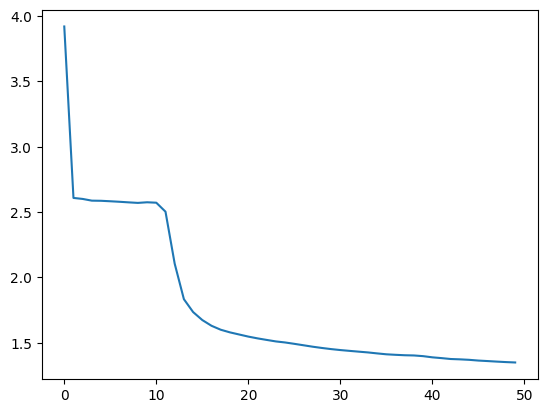

In [ ]:
# This code performs a specific task
plt.plot(range(num_epochs), losses)


In [ ]:
# This code performs a specific task
plot_images = None
recon_images = None
with torch.no_grad():
    for images, labels in dataloader:
        # Pass the batch of images through the encoder
        images = images.to(device)
        reconstructed = autoencoder(images)
        plot_images = images.cpu().numpy()
        recon_images = reconstructed.cpu().numpy()
        break


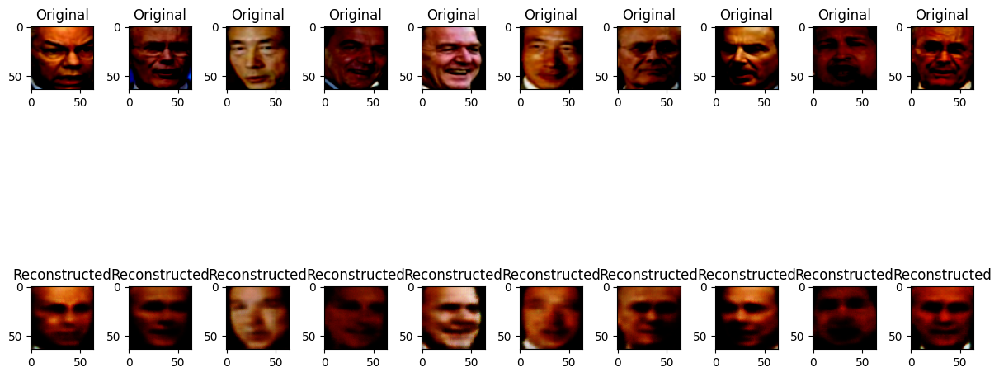

In [ ]:
# This code performs a specific task
fig, ax = plt.subplots(2, 10, figsize = (12, 8))
for i in range(10):
    ax[0, i].imshow(plot_images[i].transpose(1, 2, 0))
    ax[1, i].imshow(recon_images[i].transpose(1, 2, 0))
    ax[0, i].set_title("Original")
    ax[1, i].set_title("Reconstructed")
plt.tight_layout()

In [ ]:
# This code performs a specific task
def get_latent_representation(autoencoder, dataloader):
    latent_representations = []
    original_labels = []
    all_images = []
    with torch.no_grad():
        for images, labels in dataloader:
            # Pass the batch of images through the encoder
            images = images.to(device)
            latent_space = autoencoder.encode(images)
#             latent_space = latent_space.view(latent_space.size(0), -1)
#             latent_space =   autoencoder.fc(latent_space)
            latent_representations.append(latent_space)
            original_labels.append(labels)
            all_images.append(images)

    # Concatenate the latent representations of all batches
    latent_representations = torch.cat(latent_representations, dim=0)
    original_labels = torch.cat(original_labels, dim=0)
    all_images = torch.cat(all_images, dim=0)

    return latent_representations, all_images, original_labels


latent_representations, images, original_labels = get_latent_representation(autoencoder, dataloader)
print(latent_representations.shape)

torch.Size([480, 32])


In [ ]:
# X = latent_representations.cpu().numpy()
latent_representations_np = latent_representations.cpu().numpy()
num_clusters = 16
kmeans = KMeans(n_clusters=num_clusters, random_state=44)
kmeans.fit(latent_representations_np)
cluster_labels = kmeans.labels_

# Print the cluster labels
# print(cluster_labels)


In [ ]:
# This code performs a specific task
images = images.cpu().numpy()
original_labels = original_labels.cpu().numpy()

In [ ]:
# This code performs a specific task
set(cluster_labels)

{0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15}

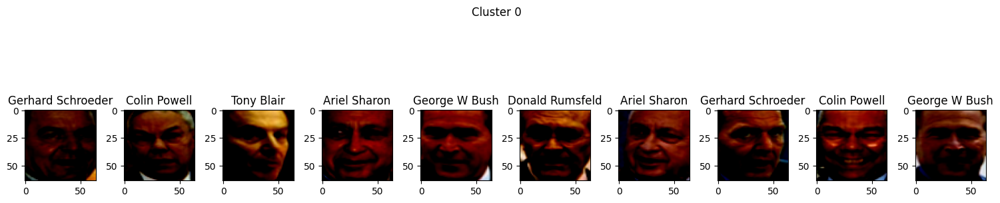

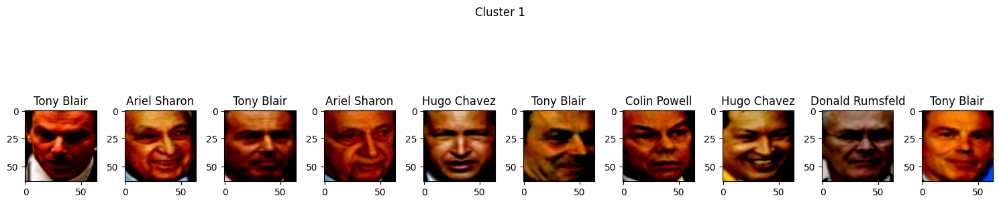

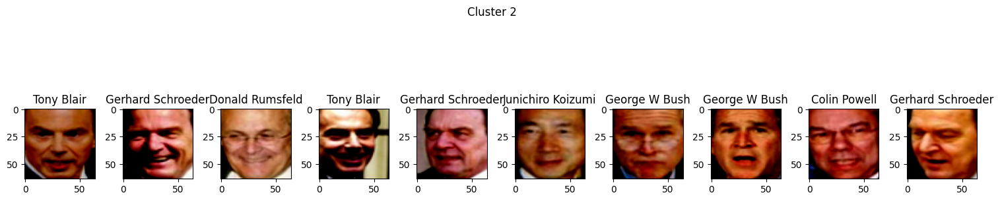

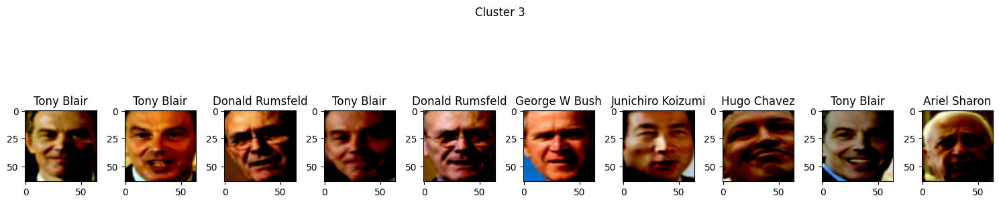

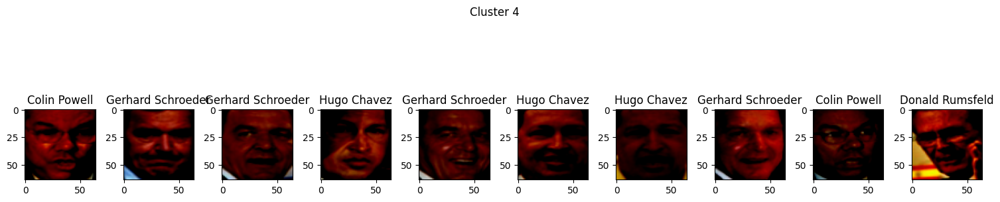

...

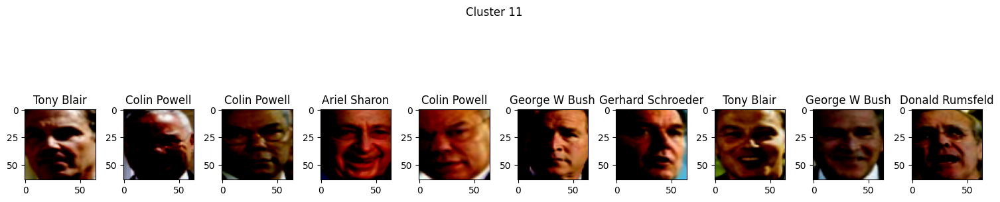

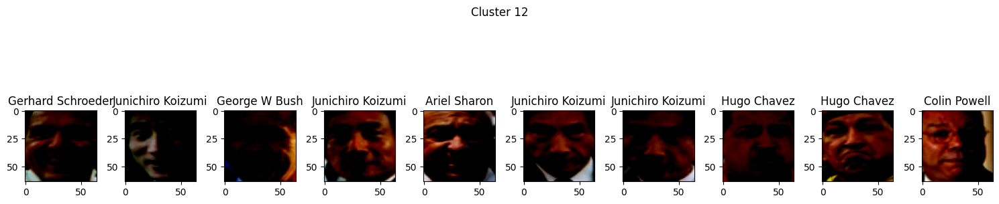

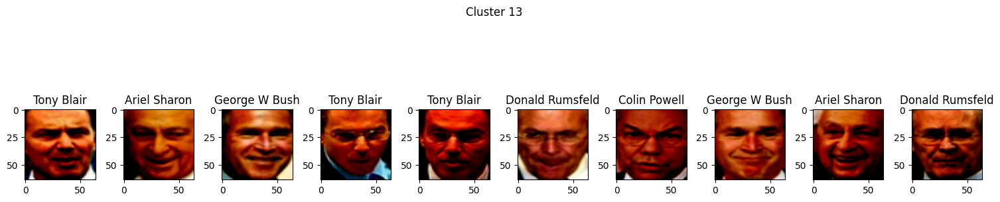

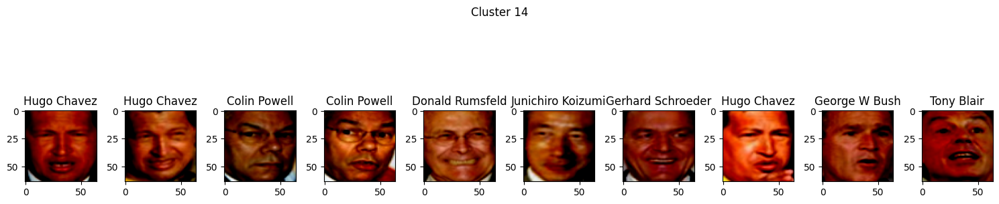

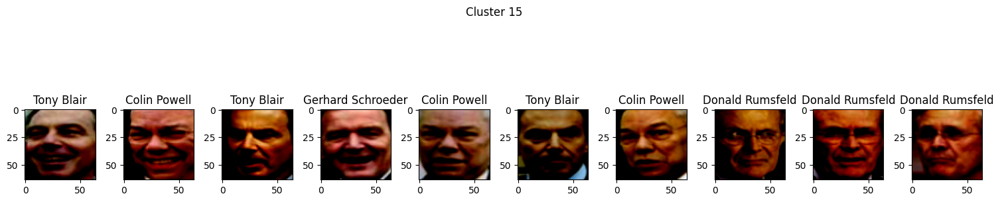

In [ ]:
# This code performs a specific task
for c in set(cluster_labels):
    cluster_i = np.where(cluster_labels == c)
    cluster_images = images[cluster_i]
    original_label = original_labels[cluster_i]
    fig, ax = plt.subplots(1, 10, figsize = (15, 4))
    for i in range(min(10, len(cluster_images))):
        ax.flatten()[i].imshow(cluster_images[i].transpose(1, 2, 0))
        ax.flatten()[i].set_title(f"{target_name[original_label[i]]}")
    fig.suptitle(f"Cluster {c}")
    plt.tight_layout()
    plt.show()


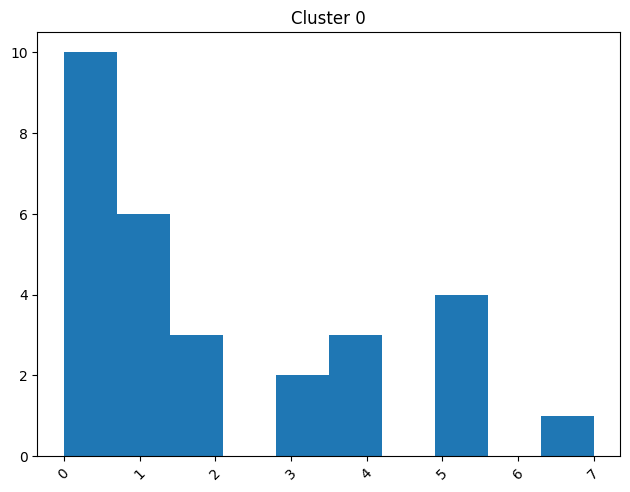

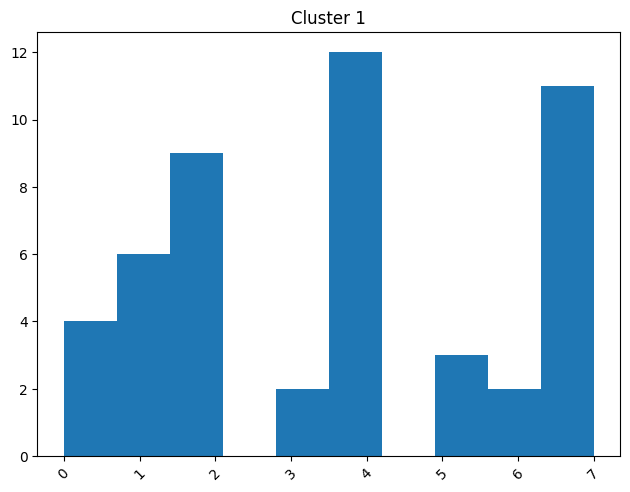

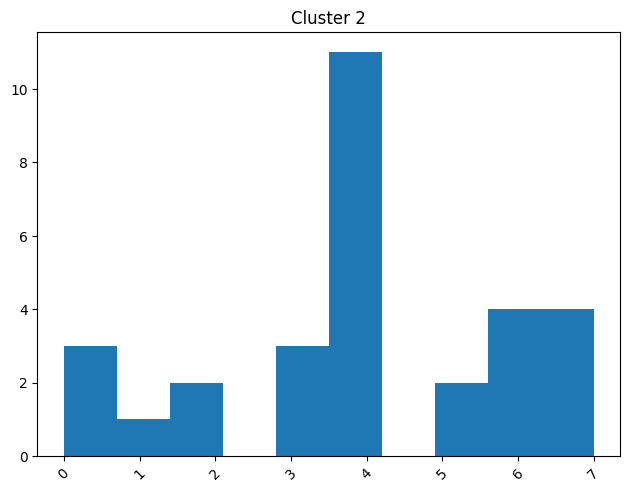

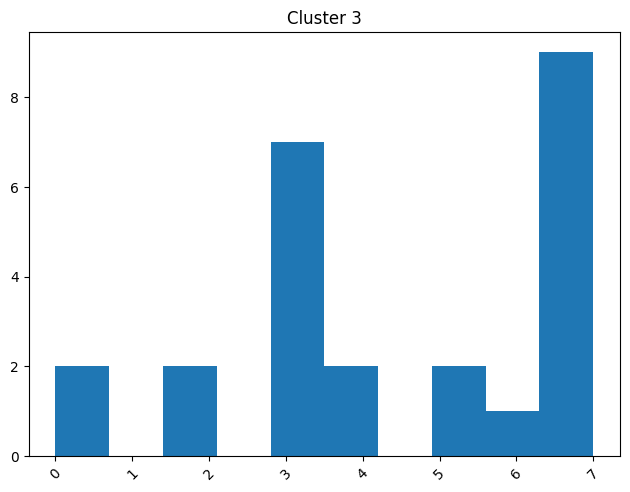

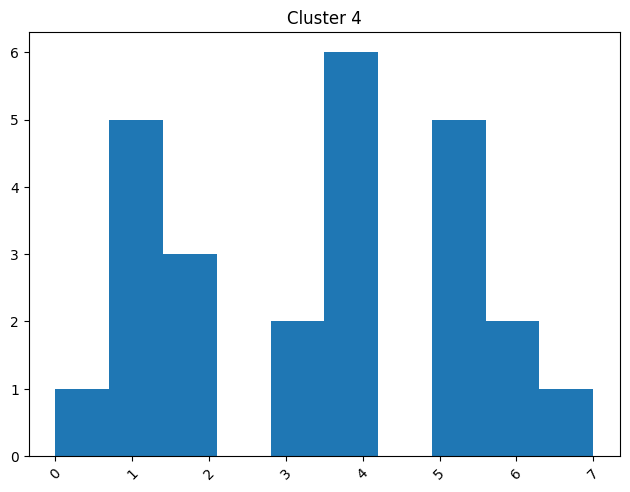

...

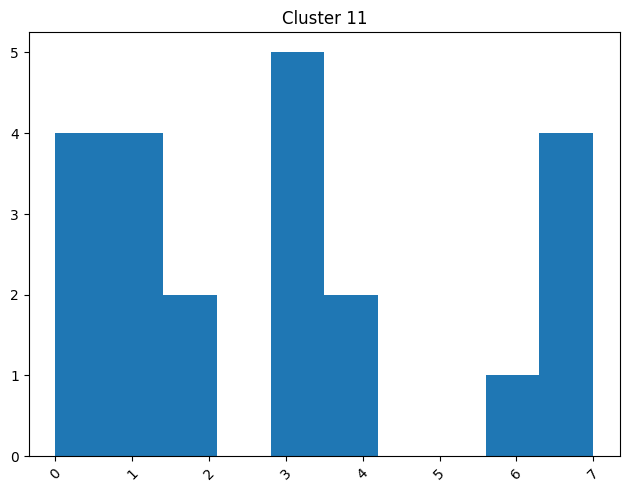

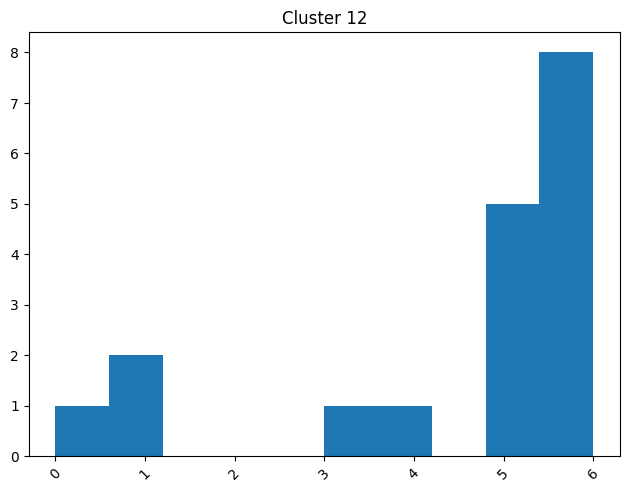

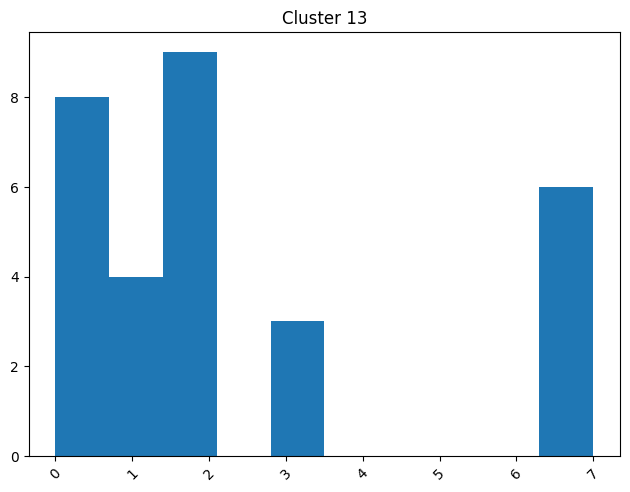

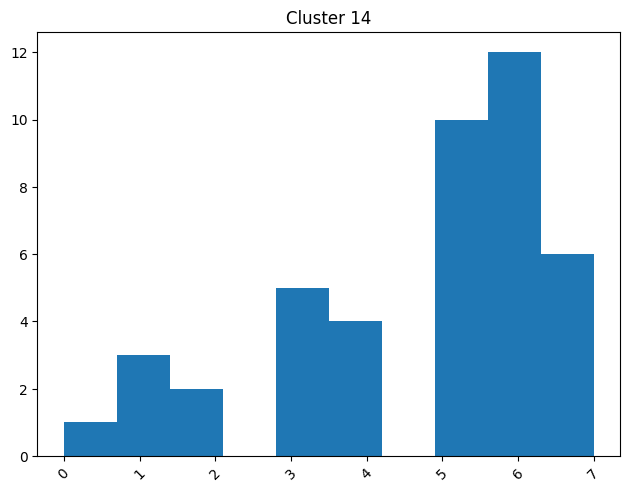

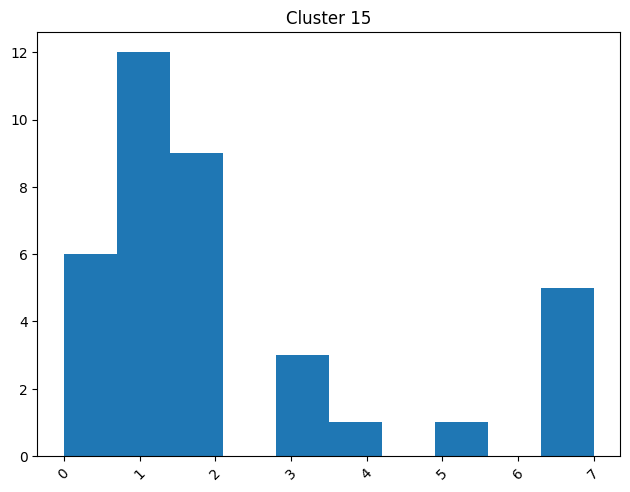

In [ ]:
# This code performs a specific task
for c in set(cluster_labels):
    cluster_i = np.where(cluster_labels == c)
    cluster_images = images[cluster_i]
    original_label = original_labels[cluster_i]
    frequency_map = Counter(target_name[original_label])
    sorted_frequency_map = dict(sorted(frequency_map.items(), key=lambda x: x[1], reverse=True))
#     print(f"cluster {c} ", sorted_frequency_map)
    plt.hist(original_label)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.title(f"Cluster {c}")
    plt.show()

## Section
This section covers an essential part of the code.
The following code is explained briefly below.
Please refer to comments for more clarity.

# Foot Ball Dataset


In [ ]:
# This code performs a specific task
import numpy as np
import cv2
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
def detect_faces(img_path):
    img = cv2.imread(img_path)
    faces = face_cascade.detectMultiScale(img, scaleFactor=1.1, minNeighbors=5, minSize=(30, 30))
    face_images = []
    for i, (x, y, w, h) in enumerate(faces):
        # Crop the detected face region
        face_image = img[y:y+h, x:x+w, :]
        face_images.append(face_image)
    if len(face_images) > 1:
#         print(len(face_images), img_path)
        fig, ax = plt.subplots(1, len(face_images))
        for i in range(len(face_images)):
            ax[i].imshow(face_images[i])

        plt.show()
    return face_images

In [ ]:
# This code performs a specific task
import os
from PIL import Image
import torch
from torch.utils.data import Dataset

class FacesData(Dataset):
    def __init__(self, images_path, transform=None):
        self.images_path = images_path
        self.image_files = os.listdir(images_path)[1:]
        self.transform = transform

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        image_name = self.image_files[idx]
        image_path = os.path.join(self.images_path, image_name)

        faces = detect_faces(image_path)
        face = None
        if len(faces) == 0:
#             face = np.ones((128, 128, 3), dtype=np.uint8)
#             face = np.random.randint(0, 256, size=(128, 128, 3), dtype=np.uint8)
              image_name = self.image_files[3]
              image_path = os.path.join(self.images_path, image_name)
              faces = detect_faces(image_path)
              face = faces[0]
        else:
            face = faces[0]
        if self.transform:
            image = cv2.cvtColor(face, cv2.COLOR_BGR2RGB)
            image = self.transform(image)
        return image

images_path = "/kaggle/input/football-cv/dataset1"
transform = transforms.Compose([
    transforms.Lambda(lambda x: (x).astype(np.uint8)),  # Scale to [0, 255] and convert to uint8
    transforms.ToPILImage(),  # Convert to PIL Image
    transforms.Resize((64, 64)),  # Resize to 64x64
    transforms.ToTensor(),  # Convert to Tensor
    transforms.Normalize((0.5,), (0.5,))
])

dataset = FacesData(images_path, transform=transform)
print("Number of images:", len(dataset))




Number of images: 128


In [ ]:
# Accessing a sample image
sample_image = dataset[0]
print("Shape of sample image tensor:", sample_image.shape)

Shape of sample image tensor: torch.Size([3, 64, 64])


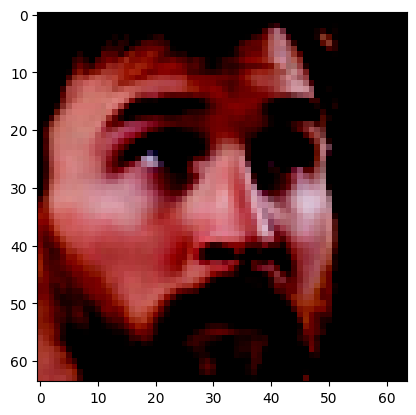

In [ ]:
# This code performs a specific task
plt.imshow(dataset[0].cpu().numpy().transpose((1,2,0)))

In [ ]:
# This code performs a specific task
dataloader = DataLoader(dataset, batch_size=32, shuffle = True)

In [ ]:
# This code performs a specific task
class Autoencoder(nn.Module):
    def __init__(self, latent_dim):
        super(Autoencoder, self).__init__()
        self.latent_dim = latent_dim

        # Encoder
        self.encoder_conv1 = nn.Conv2d(3, 32, kernel_size=3, stride=2, padding=1)
        self.encoder_conv2 = nn.Conv2d(32, 64, kernel_size=3, stride=2, padding=1)
        self.encoder_conv3 = nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1)
        self.encoder_conv4 = nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1)
        # Latent Space
        self.latent_space = nn.Linear(256 * 4 * 4, latent_dim)

        # Decoder
        self.decoder_latentSpace = nn.Linear(latent_dim, 256 * 4 * 4)
        self.decoder_conv1 = nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1)
        self.decoder_conv2 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.decoder_conv3 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.decoder_conv4 = nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1)

    def encode(self, x):
        x = F.relu(self.encoder_conv1(x))
        x = F.relu(self.encoder_conv2(x))
        x = F.relu(self.encoder_conv3(x))
        x = F.relu(self.encoder_conv4(x))
        x = x.view(x.size(0), -1)
        x = self.latent_space(x)
        return x

    def decode(self, z):
        x = F.relu(self.decoder_latentSpace(z))
        x = x.view(-1, 256, 4, 4)
        x = F.relu(self.decoder_conv1(x))
        x = F.relu(self.decoder_conv2(x))
        x = F.relu(self.decoder_conv3(x))
        x = torch.sigmoid(self.decoder_conv4(x))
        return x

    def forward(self, x):
        z = self.encode(x)
        x_recon = self.decode(z)
        return x_recon

latent_dim = 32
autoencoder = Autoencoder(latent_dim)
print(autoencoder)


Autoencoder(
  (encoder_conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (encoder_conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (encoder_conv3): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (encoder_conv4): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
  (latent_space): Linear(in_features=4096, out_features=32, bias=True)
  (decoder_latentSpace): Linear(in_features=32, out_features=4096, bias=True)
  (decoder_conv1): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (decoder_conv2): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (decoder_conv3): ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (decoder_conv4): ConvTranspose2d(32, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
)


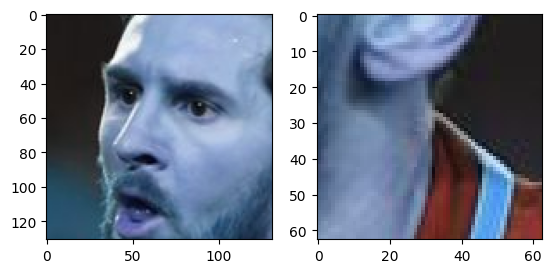

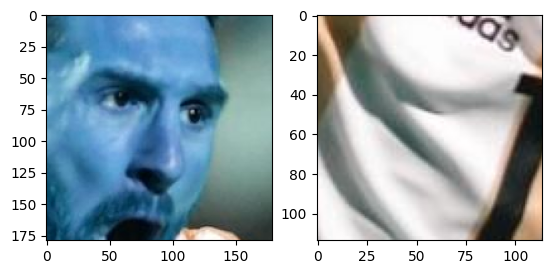

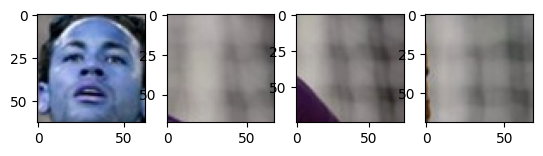

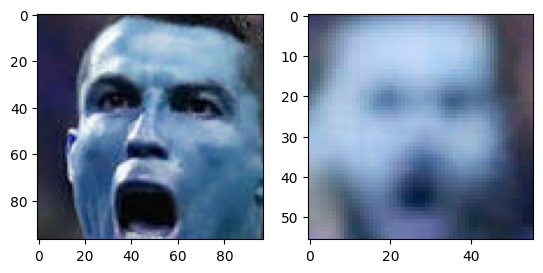

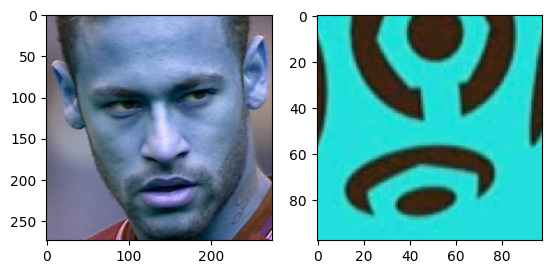

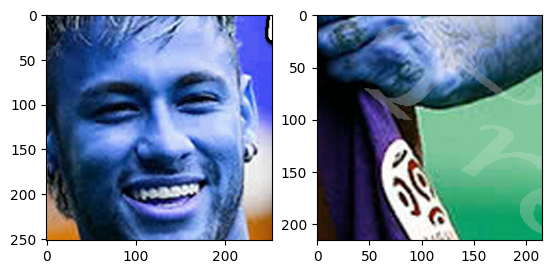

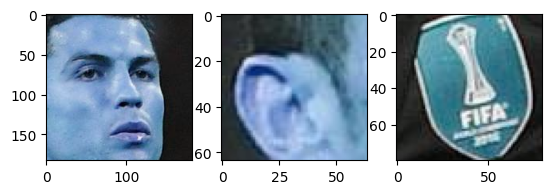

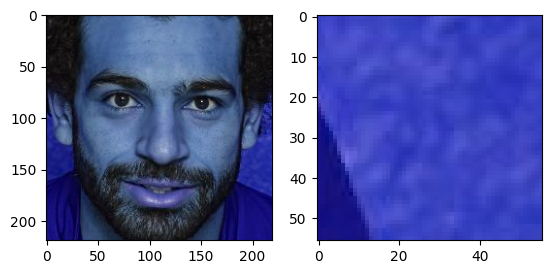

libpng warning: iCCP: known incorrect sRGB profile


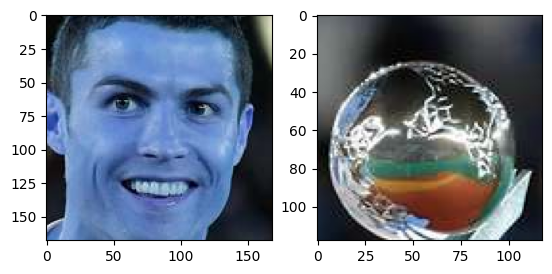

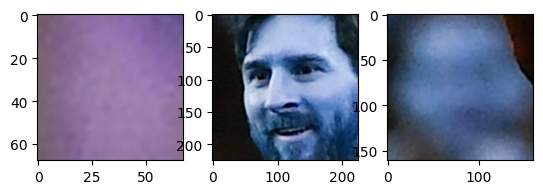

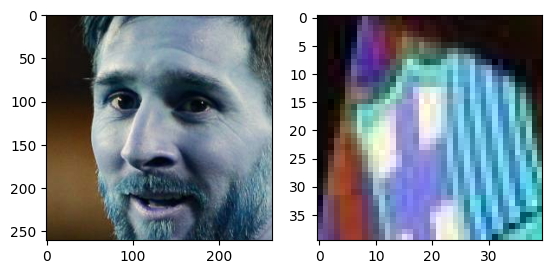

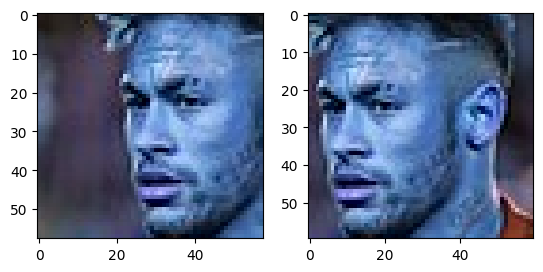

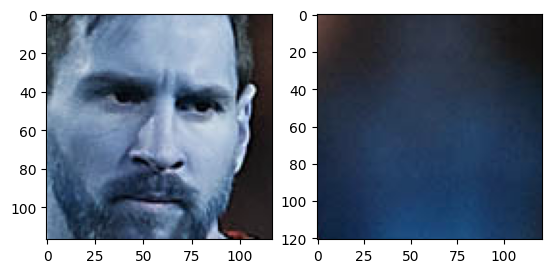

...

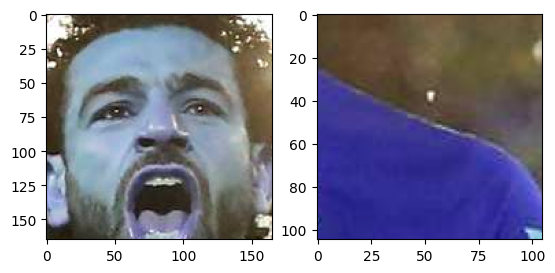

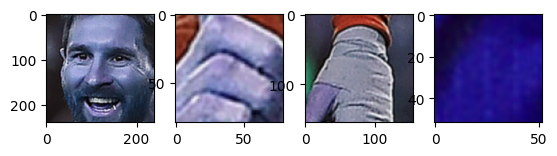

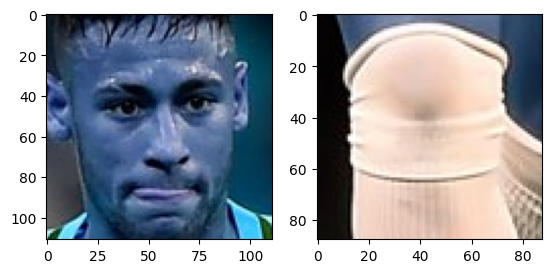

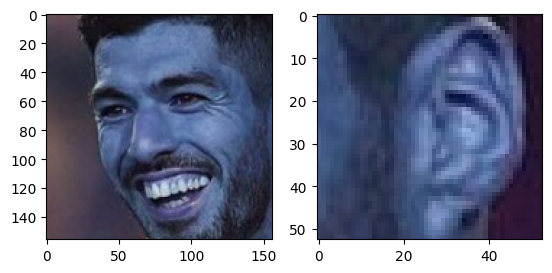

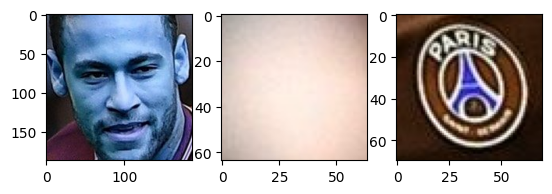

Epoch [1/10] Loss: 2.7419


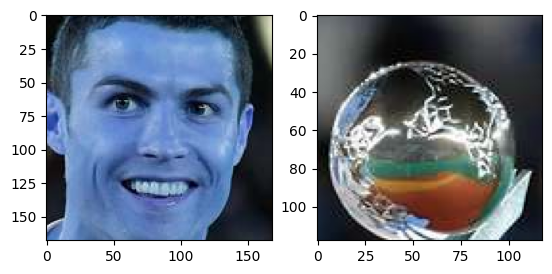

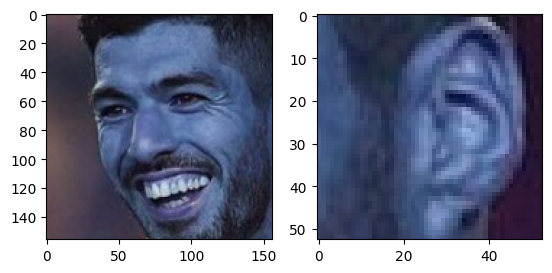

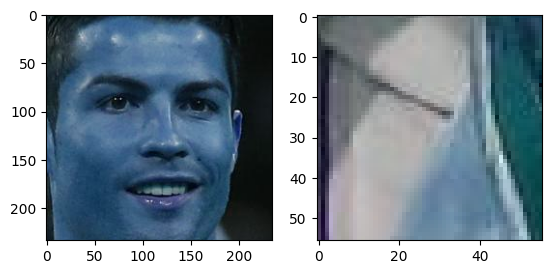

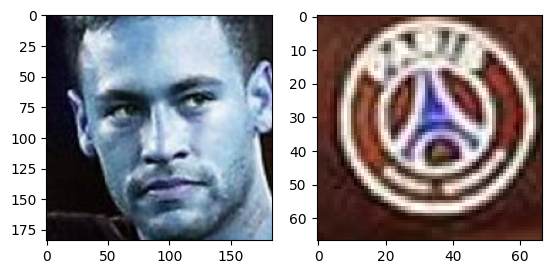

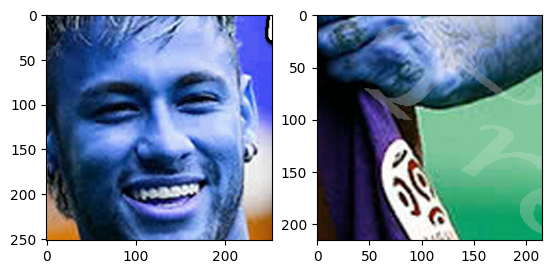

...

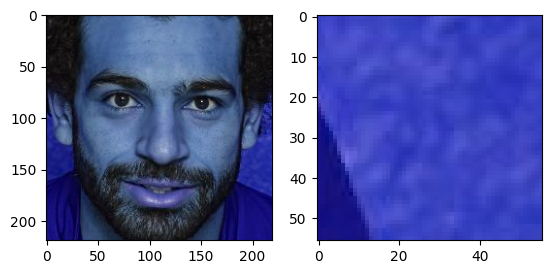

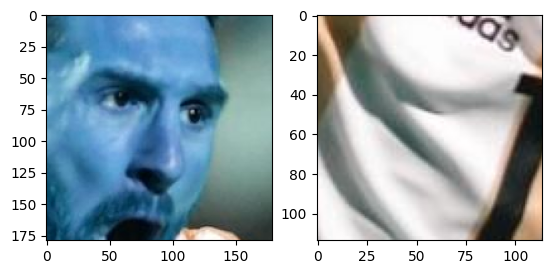

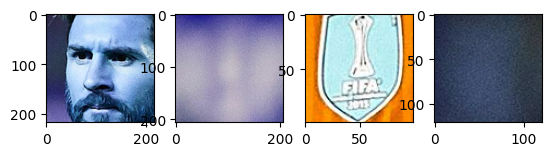

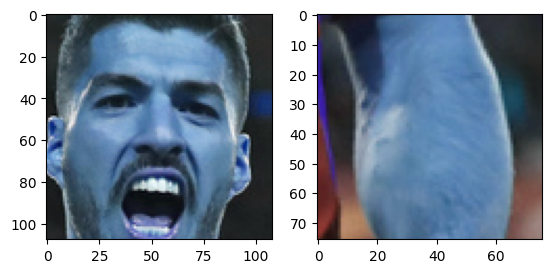

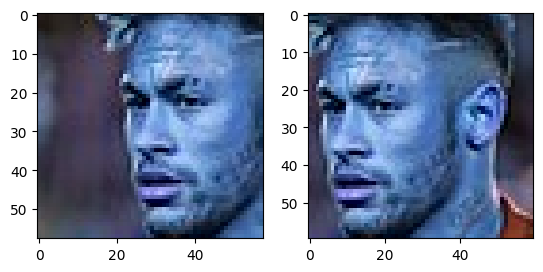

libpng warning: iCCP: known incorrect sRGB profile


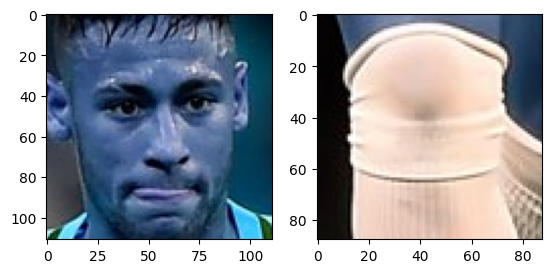

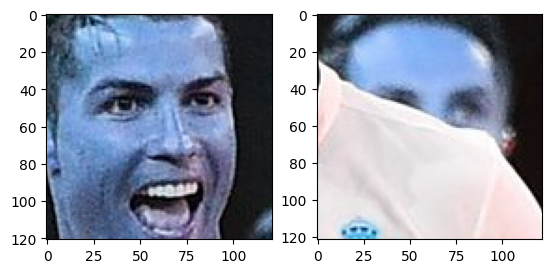

Epoch [2/10] Loss: 1.7844


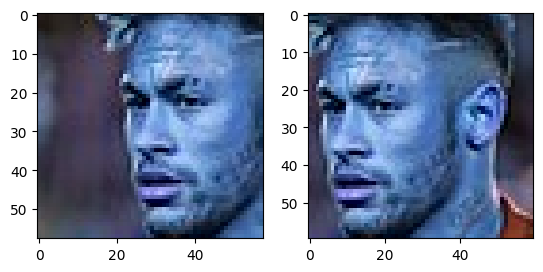

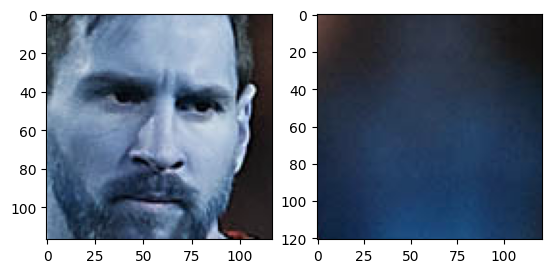

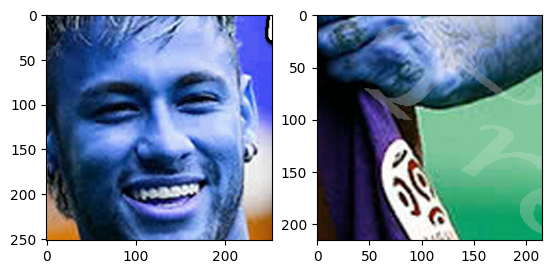

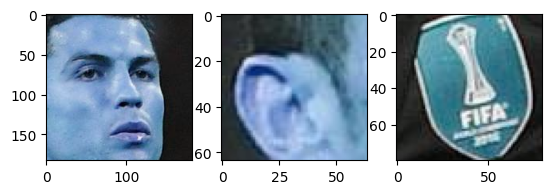

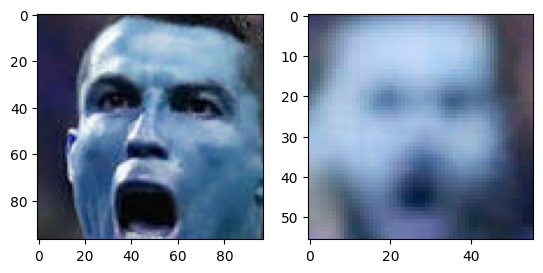

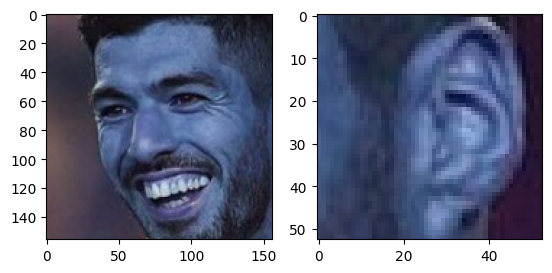

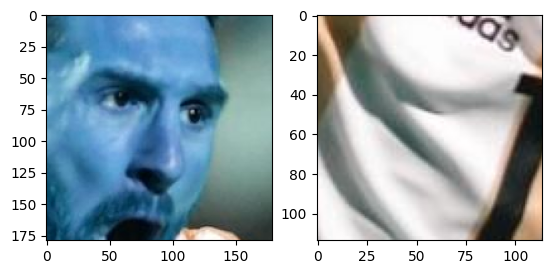

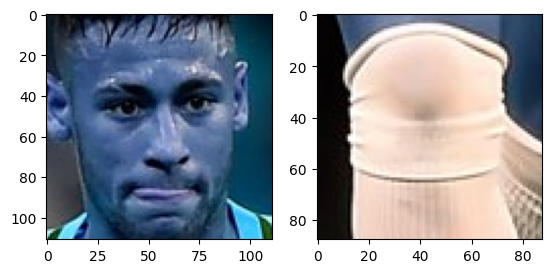

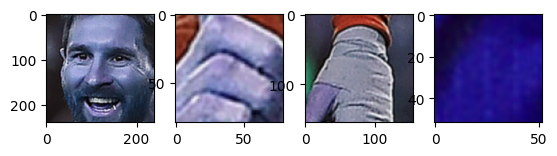

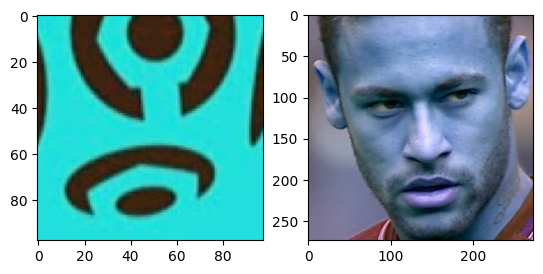

libpng warning: iCCP: known incorrect sRGB profile


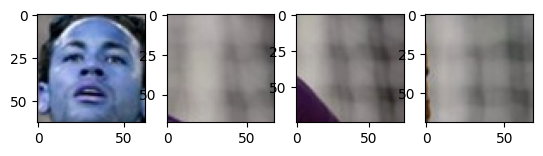

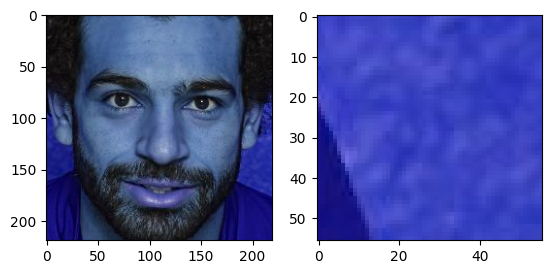

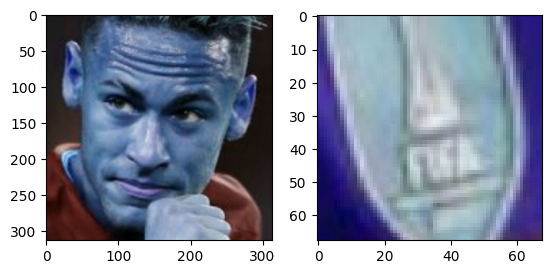

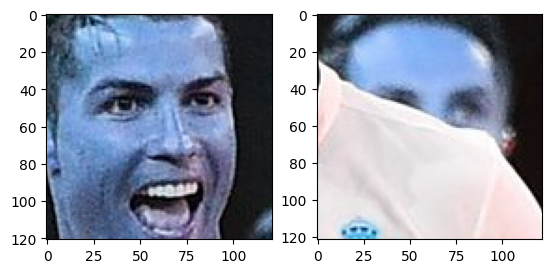

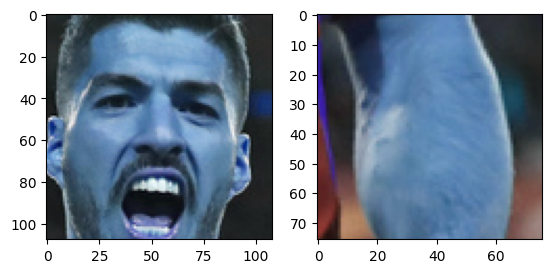

...

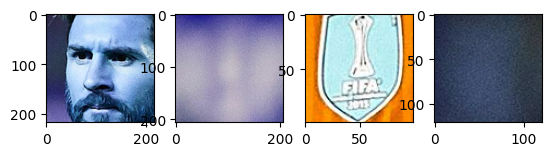

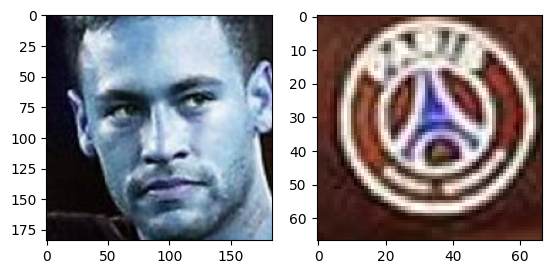

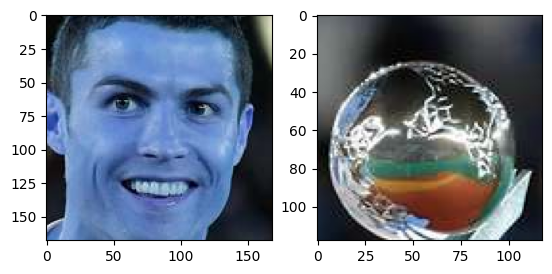

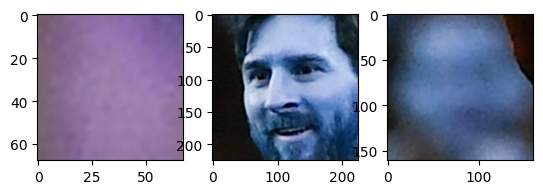

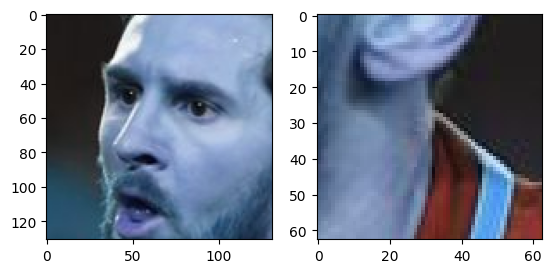

Epoch [3/10] Loss: 1.1496


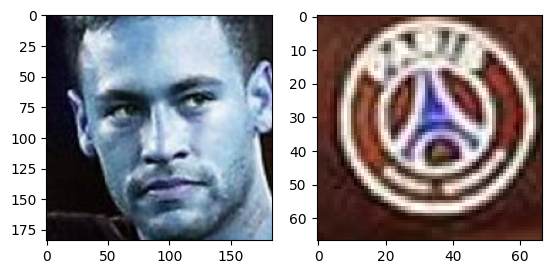

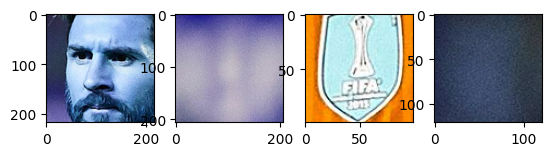

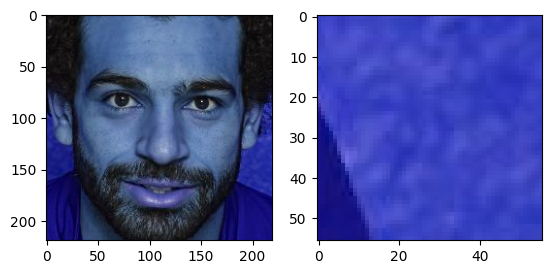

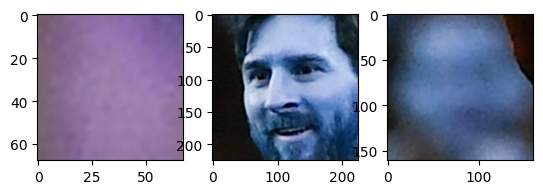

libpng warning: iCCP: known incorrect sRGB profile


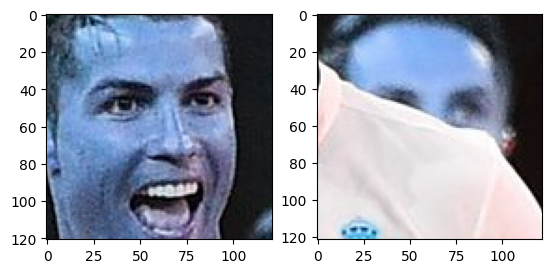

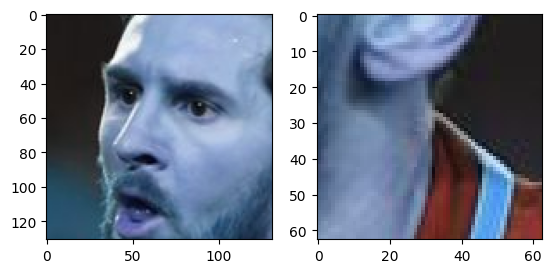

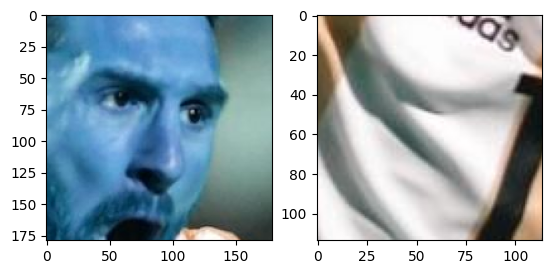

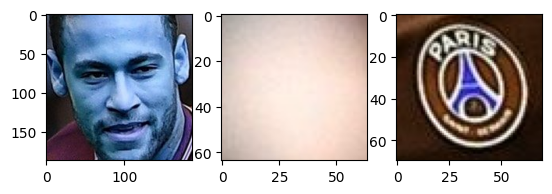

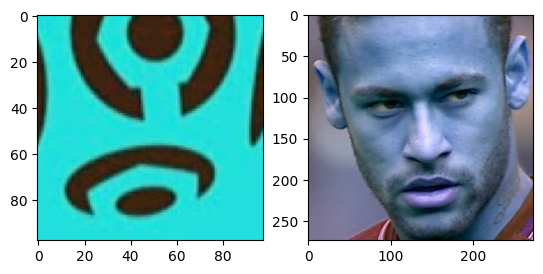

...

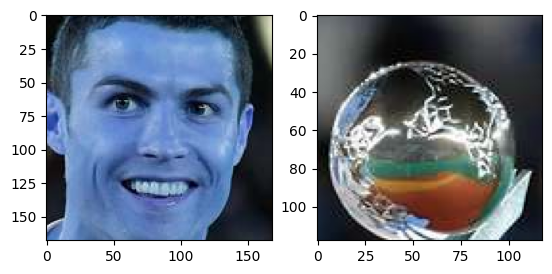

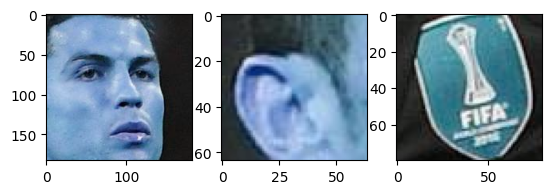

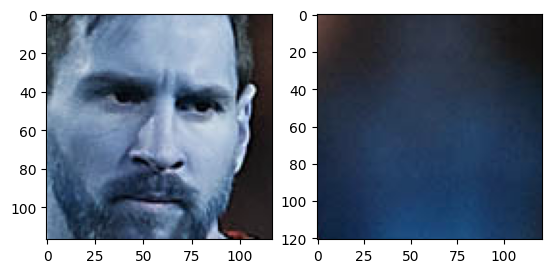

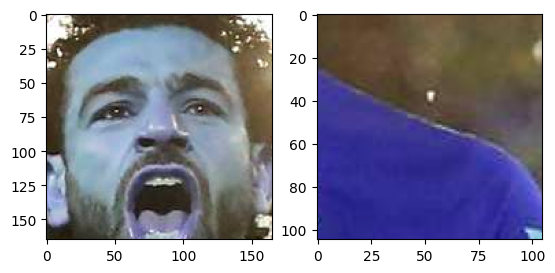

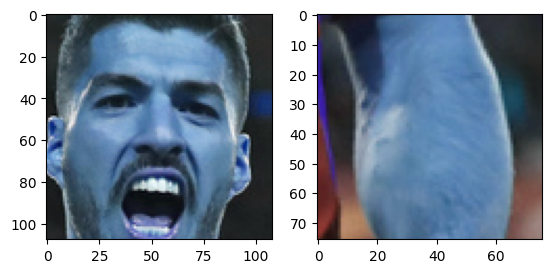

Epoch [4/10] Loss: 1.1298


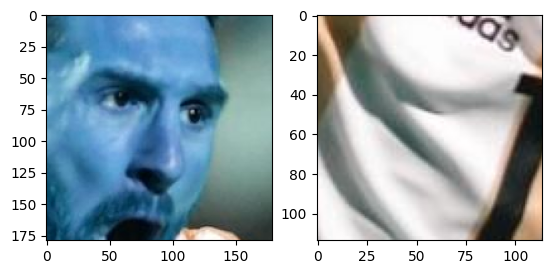

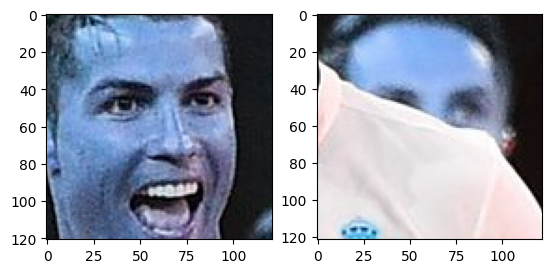

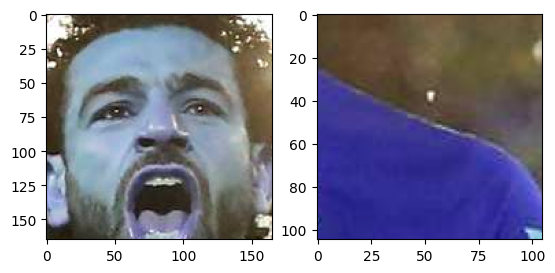

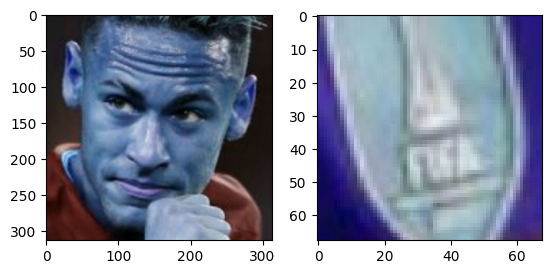

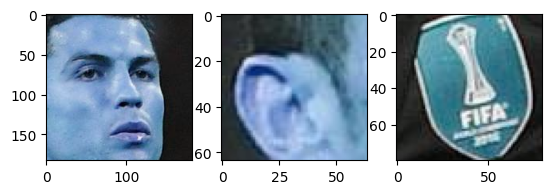

...

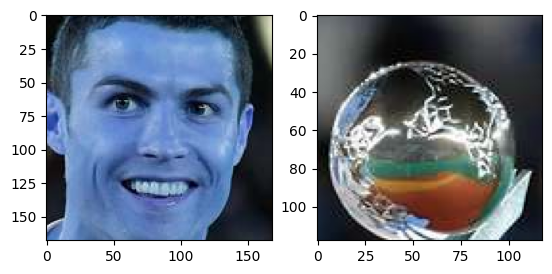

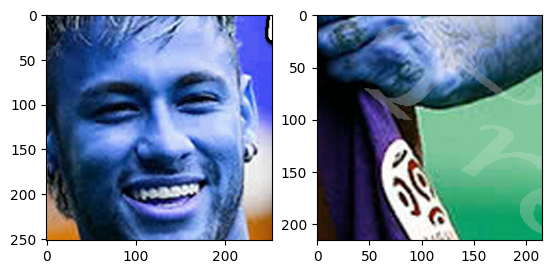

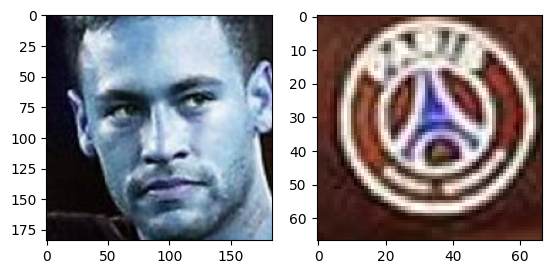

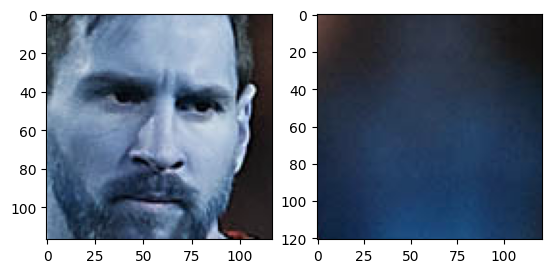

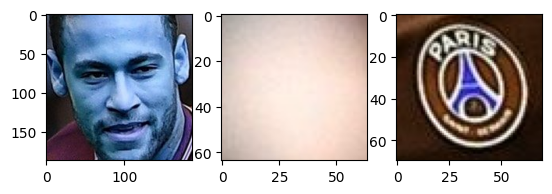

libpng warning: iCCP: known incorrect sRGB profile


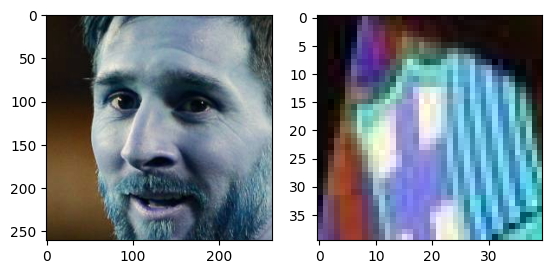

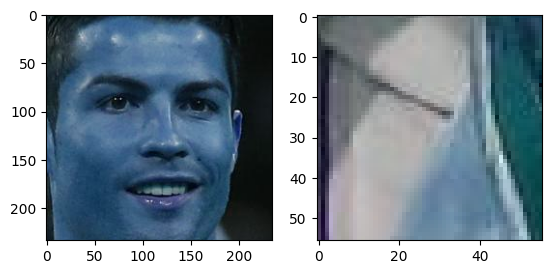

Epoch [5/10] Loss: 1.1272


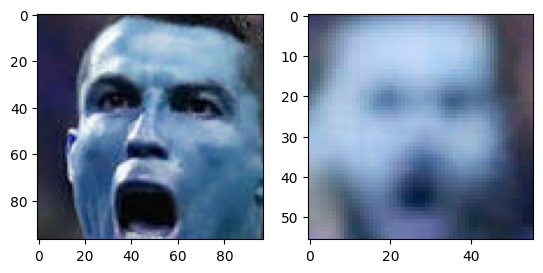

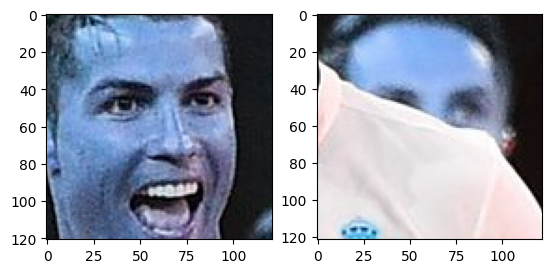

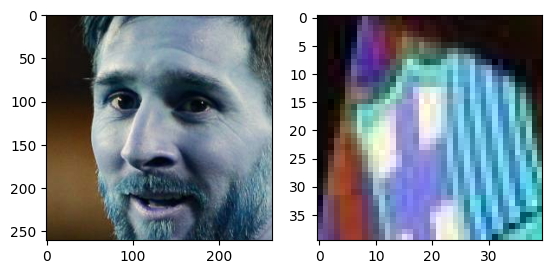

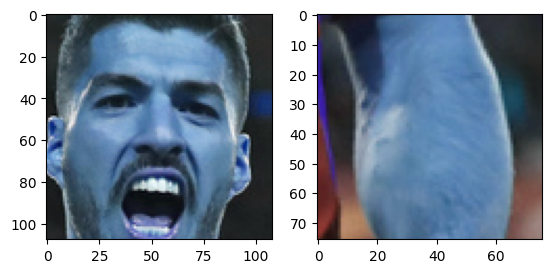

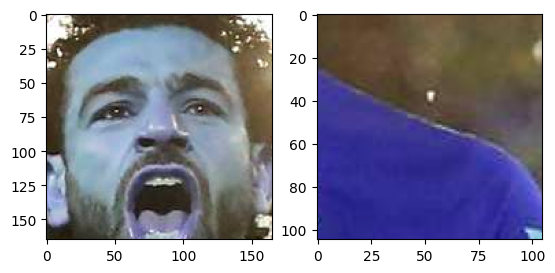

...

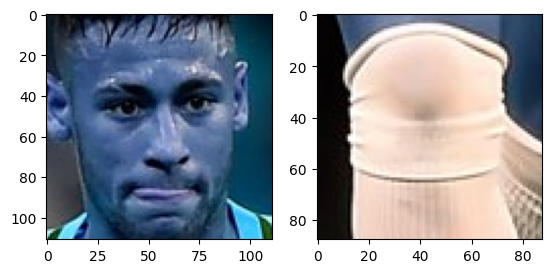

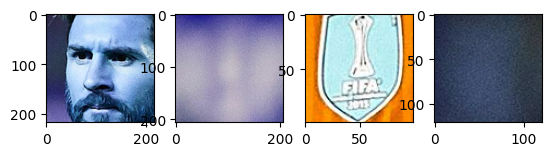

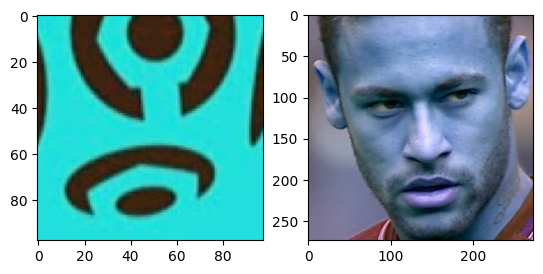

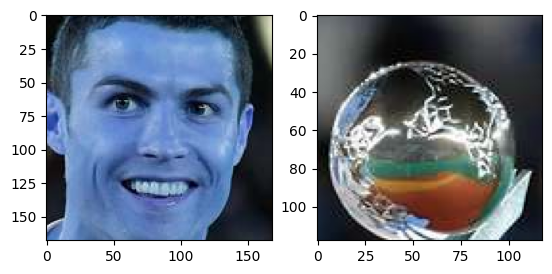

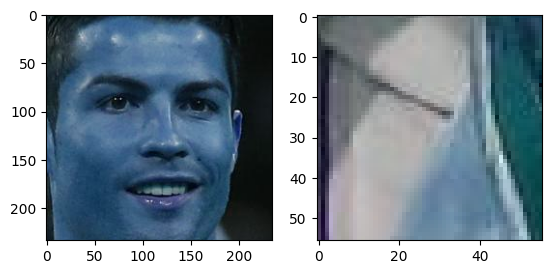

libpng warning: iCCP: known incorrect sRGB profile


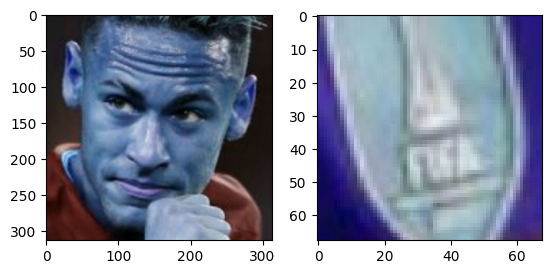

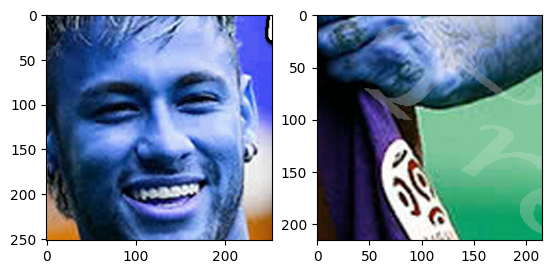

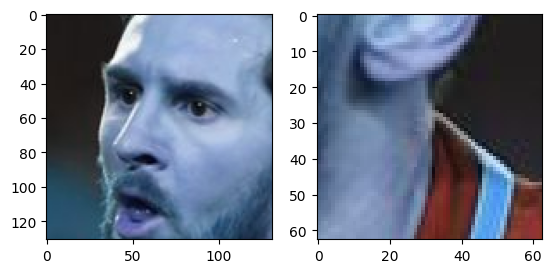

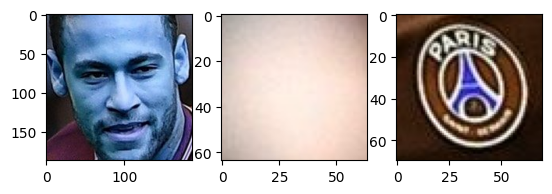

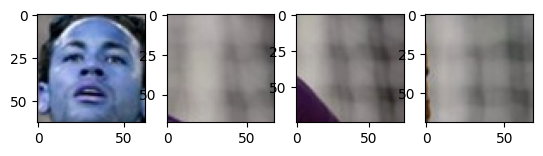

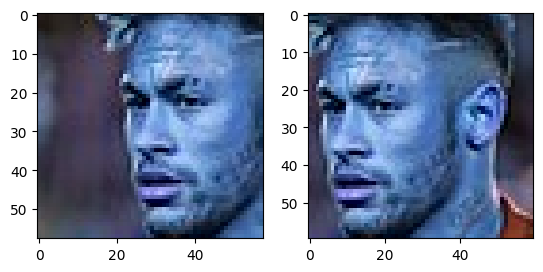

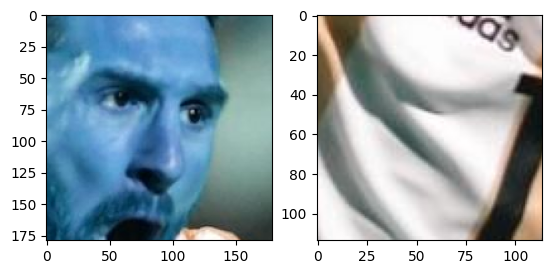

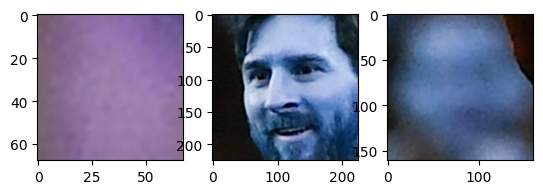

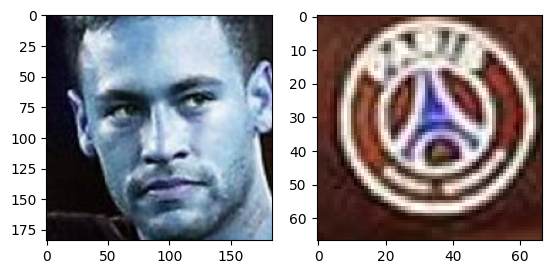

Epoch [6/10] Loss: 1.1267


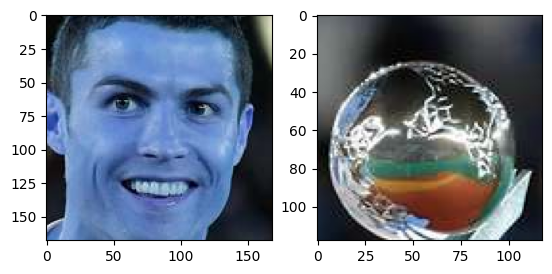

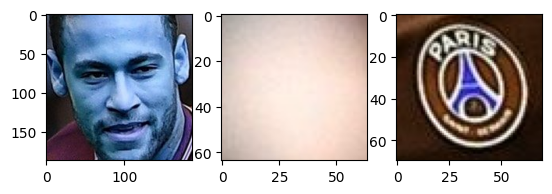

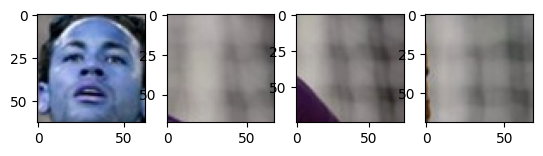

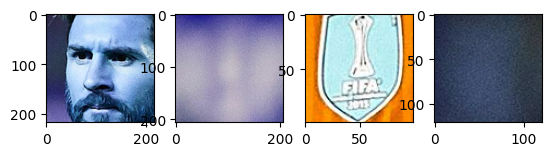

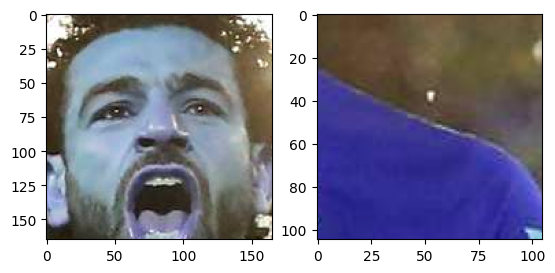

...

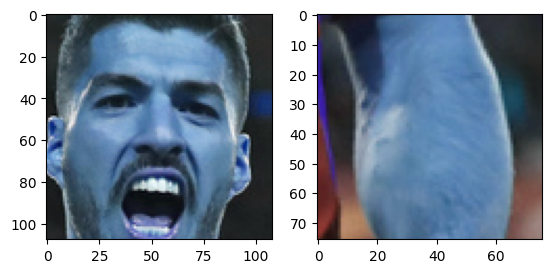

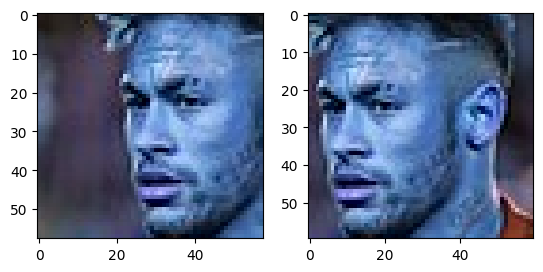

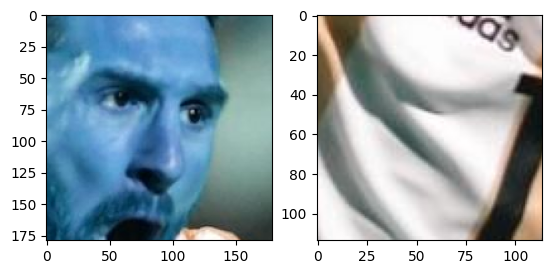

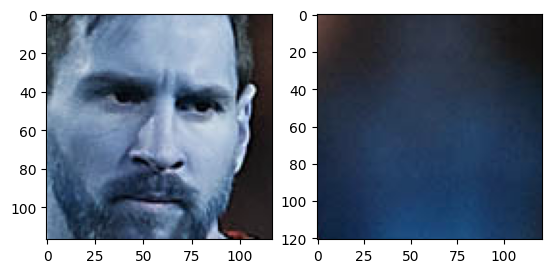

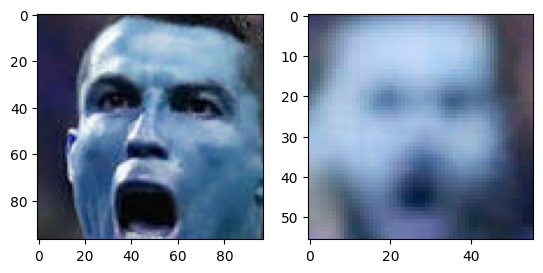

libpng warning: iCCP: known incorrect sRGB profile


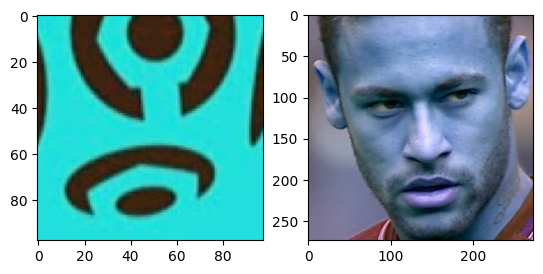

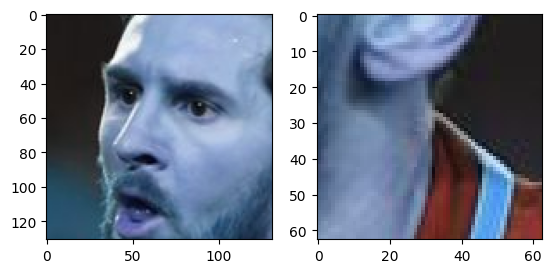

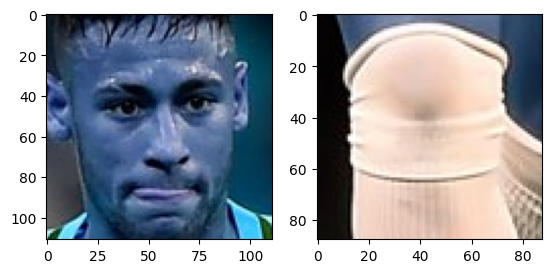

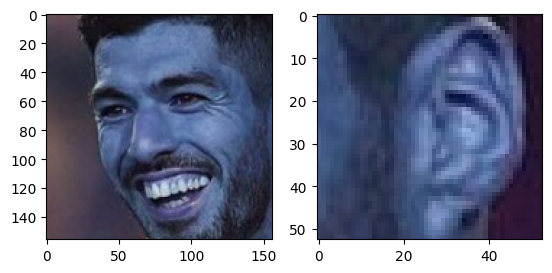

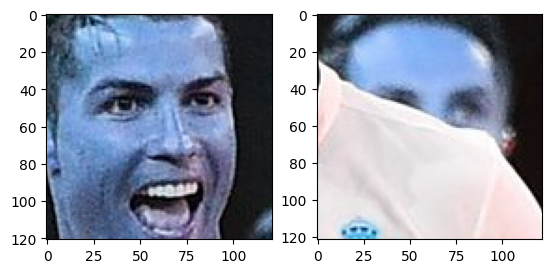

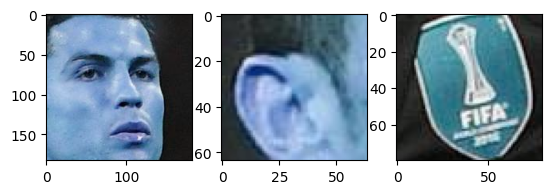

Epoch [7/10] Loss: 1.1265


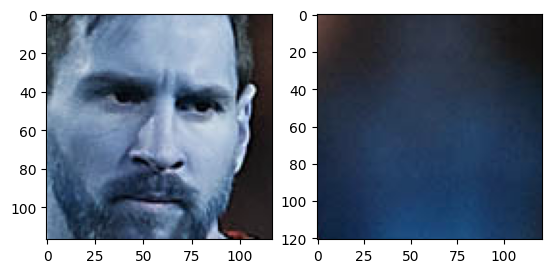

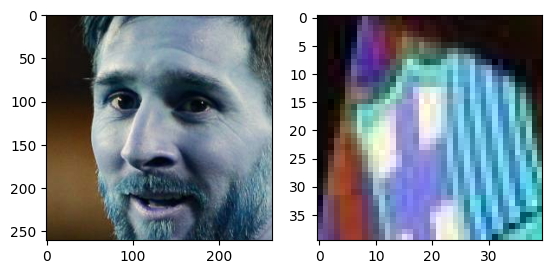

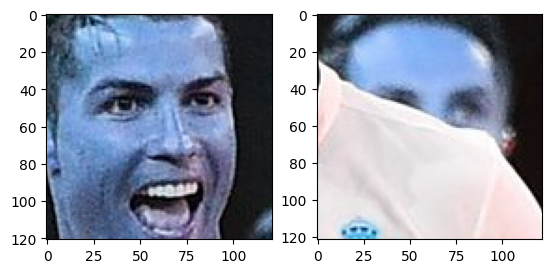

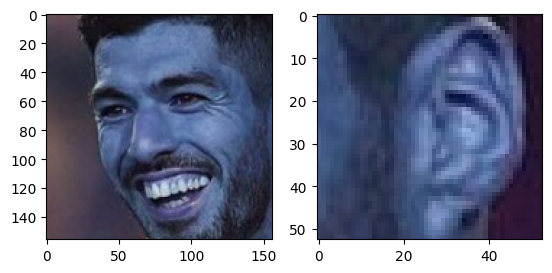

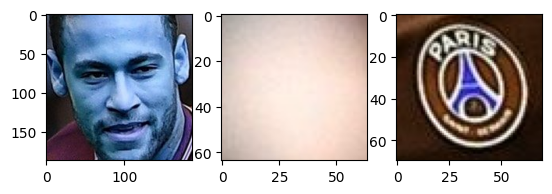

...

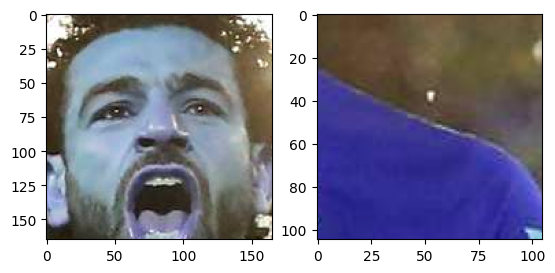

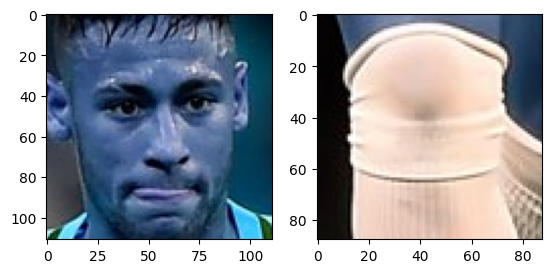

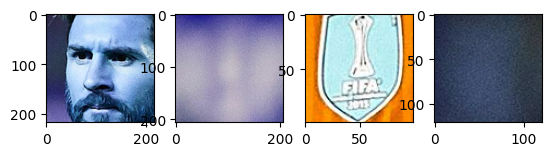

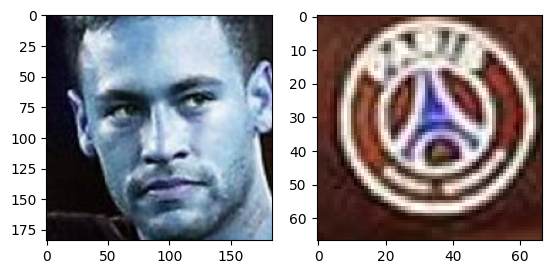

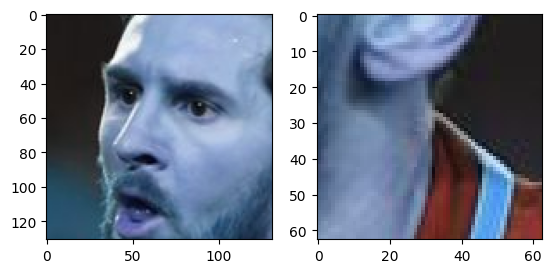

libpng warning: iCCP: known incorrect sRGB profile


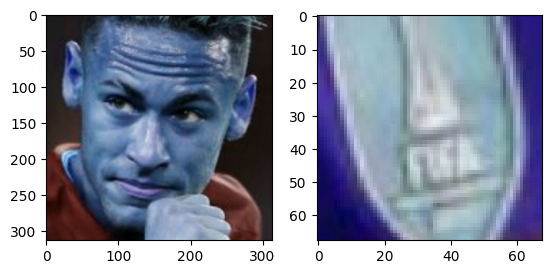

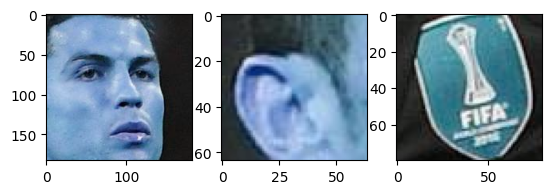

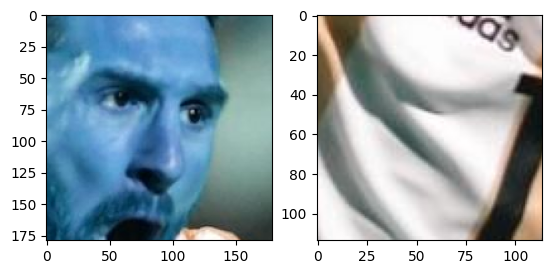

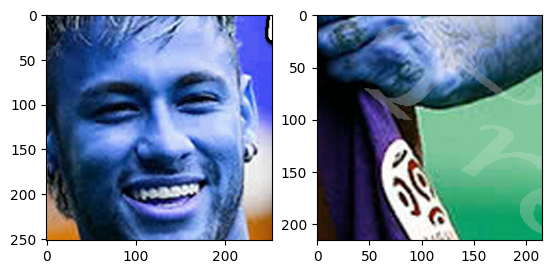

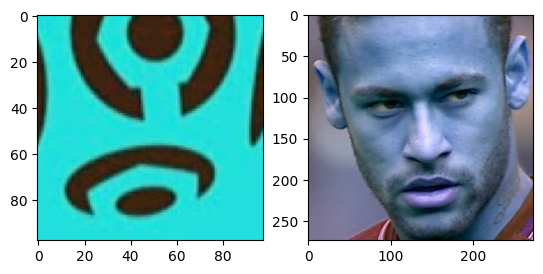

...

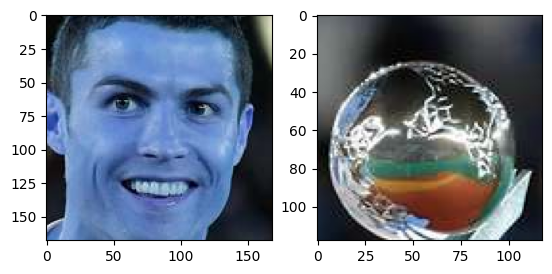

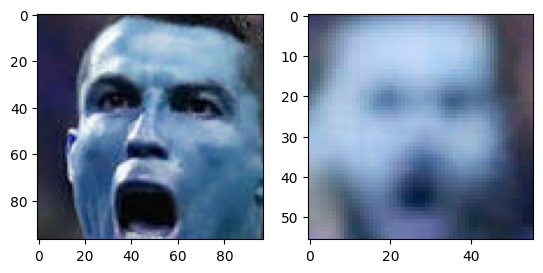

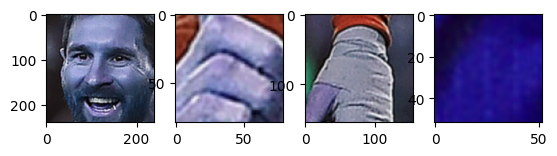

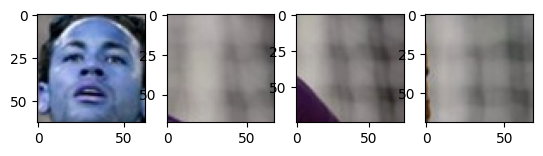

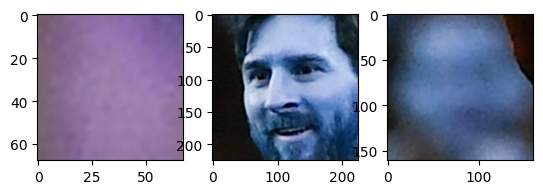

Epoch [8/10] Loss: 1.1227


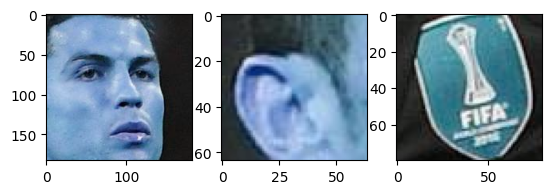

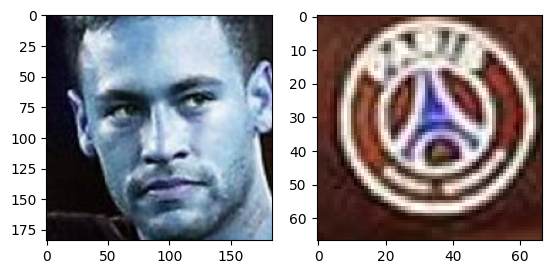

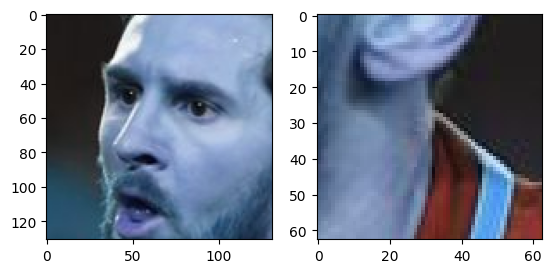

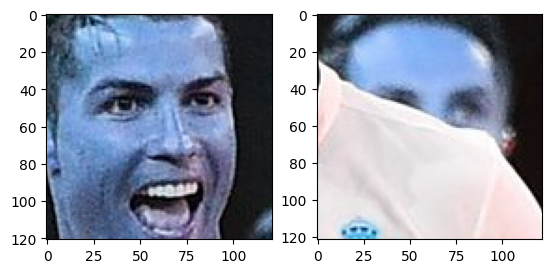

In [ ]:
# This code performs a specific task
latent_dim = 128 # Specify the latent dimension
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
autoencoder = Autoencoder(latent_dim).to(device)
criterion = nn.MSELoss()
optimizer = optim.Adam(autoencoder.parameters(), lr=0.001)
losses = []
num_epochs = 10
for epoch in range(num_epochs):
    running_loss = 0
    for batch_idx, img in enumerate(dataloader):
        # Forward pass
        img = img.to(device)
        outputs = autoencoder(img)
        loss = criterion(outputs, img)  # Reconstruction loss
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    losses.append(running_loss)
    print(f'Epoch [{epoch+1}/{num_epochs}] Loss: {running_loss:.4f}')

print('Training finished!')

In [ ]:
# This code performs a specific task
plt.plot(range(len(losses)), losses)

In [ ]:
# This code performs a specific task
plot_images = None
recon_images = None
dataloader = DataLoader(dataset, batch_size=32, shuffle = False)
with torch.no_grad():
    for images in dataloader:
        # Pass the batch of images through the encoder
        images = images.to(device)
        reconstructed = autoencoder(images)
#         print(reconstructed.shape)
        plot_images = images.cpu().numpy()
        recon_images = reconstructed.cpu().numpy()
        break


fig, ax = plt.subplots(2, 10, figsize = (12, 8))
for i in range(10):
    ax[0, i].imshow(plot_images[i].transpose(1, 2, 0))
    ax[1, i].imshow(recon_images[i].transpose(1, 2, 0))
    ax[0, i].set_title("Original")
    ax[1, i].set_title("Reconstructed")
plt.tight_layout()


In [ ]:
# This code performs a specific task
def get_latent_representation(autoencoder, dataloader):
    latent_representations = []
    original_labels = []
    all_images = []
    with torch.no_grad():
        for images in dataloader:
            # Pass the batch of images through the encoder
            images = images.to(device)
            latent_space = autoencoder.encode(images)
#             latent_space = latent_space.view(latent_space.size(0), -1)
#             latent_space =   autoencoder.fc(latent_space)
            latent_representations.append(latent_space)
            all_images.append(images)

    # Concatenate the latent representations of all batches
    latent_representations = torch.cat(latent_representations, dim=0)
#     original_labels = torch.cat(original_labels, dim=0)
    all_images = torch.cat(all_images, dim=0)

    return latent_representations, all_images


latent_representations, images = get_latent_representation(autoencoder, dataloader)
print(latent_representations.shape)

In [ ]:
# X = latent_representations.cpu().numpy()
latent_representations_np = latent_representations.cpu().numpy()
num_clusters = 4
kmeans = KMeans(n_clusters=num_clusters, random_state=44)
kmeans.fit(latent_representations_np)
cluster_labels = kmeans.labels_

# Print the cluster labels
# print(cluster_labels)


In [ ]:
# This code performs a specific task
cluster_labels

In [ ]:
# This code performs a specific task
for c in set(cluster_labels):
    cluster_i = np.where(cluster_labels == c)[0]
    fig, ax = plt.subplots(1, 10, figsize = (15, 4))
    for i in range(min(10, len(cluster_i))):
#         print(cluster_i[i])
#         print(dataset[cluster_i[i]])
        ax.flatten()[i].imshow(dataset[cluster_i[i]].cpu().numpy().transpose(1, 2, 0))
#         ax.flatten()[i].set_title(f"{target_name[original_label[i]]}")
    fig.suptitle(f"Cluster {c}")
    plt.tight_layout()
    plt.show()


In [ ]:
# This code performs a specific task


In [ ]:
# This code performs a specific task
